# Projet Final Python for Data Analysis

Anne-Solène IZARD
Christelle LE VAN KAHN
Lily LA MORELLA

IMPORTS

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.figure_factory as ff
import warnings


C:\Users\lilyj\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


Dataset 

In [2]:
diabetic = pd.read_csv("diabetic_data.csv", sep=',')
#Afficher les premières lignes du Dataset
diabetic.head()

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),?,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),?,1,1,7,3,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),?,1,1,7,2,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),?,1,1,7,2,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),?,1,1,7,1,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


In [3]:
#Taille du Dataset
diabetic.shape

(101766, 50)

In [4]:
diabetic = diabetic.replace("?",np.nan)
len(diabetic.select_dtypes('O').columns)

37

In [5]:
#Description des colonnes numériques
diabetic.describe()

,encounter_id,patient_nbr,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
count,1.017660e+05,1.017660e+05,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000
mean,1.652016e+08,5.433040e+07,2.024006,3.715642,5.754437,4.395987,43.095641,1.339730,16.021844,0.369357,0.197836,0.635566,7.422607
std,1.026403e+08,3.869636e+07,1.445403,5.280166,4.064081,2.985108,19.674362,1.705807,8.127566,1.267265,0.930472,1.262863,1.933600
min,1.252200e+04,1.350000e+02,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
25%,8.496119e+07,2.341322e+07,1.000000,1.000000,1.000000,2.000000,31.000000,0.000000,10.000000,0.000000,0.000000,0.000000,6.000000
50%,1.523890e+08,4.550514e+07,1.000000,1.000000,7.000000,4.000000,44.000000,1.000000,15.000000,0.000000,0.000000,0.000000,8.000000
75%,2.302709e+08,8.754595e+07,3.000000,4.000000,7.000000,6.000000,57.000000,2.000000,20.000000,0.000000,0.000000,1.000000,9.000000
max,4.438672e+08,1.895026e+08,8.000000,28.000000,25.000000,14.000000,132.000000,6.000000,81.000000,42.000000,76.000000,21.000000,16.000000


In [6]:
#Informations générales
diabetic.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 50 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   encounter_id              101766 non-null  int64 
 1   patient_nbr               101766 non-null  int64 
 2   race                      99493 non-null   object
 3   gender                    101766 non-null  object
 4   age                       101766 non-null  object
 5   weight                    3197 non-null    object
 6   admission_type_id         101766 non-null  int64 
 7   discharge_disposition_id  101766 non-null  int64 
 8   admission_source_id       101766 non-null  int64 
 9   time_in_hospital          101766 non-null  int64 
 10  payer_code                61510 non-null   object
 11  medical_specialty         51817 non-null   object
 12  num_lab_procedures        101766 non-null  int64 
 13  num_procedures            101766 non-null  int64 
 14  num_

In [7]:
#Valeurs manquantes
diabetic.isnull().sum()

encounter_id                    0
patient_nbr                     0
race                         2273
gender                          0
age                             0
weight                      98569
admission_type_id               0
discharge_disposition_id        0
admission_source_id             0
time_in_hospital                0
payer_code                  40256
medical_specialty           49949
num_lab_procedures              0
num_procedures                  0
num_medications                 0
number_outpatient               0
number_emergency                0
number_inpatient                0
diag_1                         21
diag_2                        358
diag_3                       1423
number_diagnoses                0
max_glu_serum                   0
A1Cresult                       0
metformin                       0
repaglinide                     0
nateglinide                     0
chlorpropamide                  0
glimepiride                     0
acetohexamide 

In [8]:
#pourcentage de valeurs nulles
diabetic.isnull().sum()[diabetic.isnull().sum()>1]/len(diabetic)*100

race                  2.233555
weight               96.858479
payer_code           39.557416
medical_specialty    49.082208
diag_1                0.020636
diag_2                0.351787
diag_3                1.398306
dtype: float64

We decide to delete the columns with a Null rate exceeding 35%.

The 'weight' column has over 96% missing values.

The 'payer_code' column has over 39%.

And the 'medical_speciality' column has over 49%.

In [9]:
#Valeurs dupliquées
diabetic.duplicated().sum()

0

In [10]:
#Valeurs uniques par colonnes
diabetic.nunique()

encounter_id                101766
patient_nbr                  71518
race                             5
gender                           3
age                             10
weight                           9
admission_type_id                8
discharge_disposition_id        26
admission_source_id             17
time_in_hospital                14
payer_code                      17
medical_specialty               72
num_lab_procedures             118
num_procedures                   7
num_medications                 75
number_outpatient               39
number_emergency                33
number_inpatient                21
diag_1                         716
diag_2                         748
diag_3                         789
number_diagnoses                16
max_glu_serum                    4
A1Cresult                        4
metformin                        4
repaglinide                      4
nateglinide                      4
chlorpropamide                   4
glimepiride         

Examide and citoglipton contain only one value in their column, we will drop them. Let's check the columns with 2 different values.

In [11]:
for column in diabetic.columns:
    if diabetic[column].nunique() == 2:
        print(diabetic[column].value_counts())

No        101765
Steady         1
Name: acetohexamide, dtype: int64
No        101743
Steady        23
Name: tolbutamide, dtype: int64
No        101763
Steady         3
Name: troglitazone, dtype: int64
No        101753
Steady        13
Name: glipizide-metformin, dtype: int64
No        101765
Steady         1
Name: glimepiride-pioglitazone, dtype: int64
No        101764
Steady         2
Name: metformin-rosiglitazone, dtype: int64
No        101765
Steady         1
Name: metformin-pioglitazone, dtype: int64
No    54755
Ch    47011
Name: change, dtype: int64
Yes    78363
No     23403
Name: diabetesMed, dtype: int64


"The columns to be deleted as they almost have only one value are: acetohexamide, troglitazone, glipizide-metformin, glimepiride-pioglitazone, metformin-rosiglitazone, metformin-pioglitazone, tolbutamide."

In [12]:
#Vérifions pour les colonnes ayant entre 3 et 5 valeurs différentes
for column in diabetic.columns:
    unique_values_count = diabetic[column].nunique()
    if 2 < unique_values_count <= 5:
        print(f"\nColumn: {column}")
        print(diabetic[column].value_counts(normalize=True) * 100)


Column: race
Caucasian          76.486788
AfricanAmerican    19.307891
Hispanic            2.047380
Other               1.513674
Asian               0.644266
Name: race, dtype: float64

Column: gender
Female             53.758623
Male               46.238429
Unknown/Invalid     0.002948
Name: gender, dtype: float64

Column: max_glu_serum
None    94.746772
Norm     2.551933
>200     1.459230
>300     1.242065
Name: max_glu_serum, dtype: float64

Column: A1Cresult
None    83.277322
>8       8.073423
Norm     4.903406
>7       3.745848
Name: A1Cresult, dtype: float64

Column: metformin
No        80.358862
Steady    18.027632
Up         1.048484
Down       0.565022
Name: metformin, dtype: float64

Column: repaglinide
No        98.487707
Steady     1.359983
Up         0.108091
Down       0.044219
Name: repaglinide, dtype: float64

Column: nateglinide
No        99.309200
Steady     0.656408
Up         0.023584
Down       0.010809
Name: nateglinide, dtype: float64

Column: chlorpropamide
No 

We decide to delete the columns that have more than 98% of the same value: repaglinide, nateglinide, chlorpropamide, acarbose, miglitol, tolazamide, glyburide-metformin. We also need to remove the rows in "sex" that are unknown".

In [13]:
unknown_gender_rows = diabetic[diabetic['gender'] == 'Unknown/Invalid']
unknown_gender_rows

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
30506,98634858,100695042,Other,Unknown/Invalid,[70-80),NaN,3,1,1,1,...,No,No,No,No,No,No,No,Ch,Yes,NO
75551,226864668,60524946,NaN,Unknown/Invalid,[60-70),NaN,1,1,7,1,...,No,No,No,No,No,No,No,No,No,NO
82573,257364294,78119847,NaN,Unknown/Invalid,[70-80),NaN,1,22,7,8,...,No,No,No,No,No,No,No,Ch,Yes,NO


In [14]:
#on drop les unknow race (3lignes)
diabetic = diabetic.drop(diabetic[diabetic['gender'] == 'Unknown/Invalid'].index)

In [15]:
diabetic_selected = diabetic.loc[:, ['weight', 'payer_code', 'medical_specialty', 'examide', 'citoglipton','acetohexamide', 'troglitazone', 'glipizide-metformin', 'glimepiride-pioglitazone','metformin-rosiglitazone', 'metformin-pioglitazone', 'tolbutamide','repaglinide', 'nateglinide', 'chlorpropamide', 'acarbose', 'miglitol', 'tolazamide','glyburide-metformin']]
print(diabetic_selected)


       weight payer_code         medical_specialty examide citoglipton  \
0         NaN        NaN  Pediatrics-Endocrinology      No          No   
1         NaN        NaN                       NaN      No          No   
2         NaN        NaN                       NaN      No          No   
3         NaN        NaN                       NaN      No          No   
4         NaN        NaN                       NaN      No          No   
...       ...        ...                       ...     ...         ...   
101761    NaN         MC                       NaN      No          No   
101762    NaN         MC                       NaN      No          No   
101763    NaN         MC                       NaN      No          No   
101764    NaN         MC           Surgery-General      No          No   
101765    NaN        NaN                       NaN      No          No   

       acetohexamide troglitazone glipizide-metformin  \
0                 No           No                  No 

In [16]:
diabetic.drop(['weight', 'payer_code', 'medical_specialty', 'examide', 'citoglipton','acetohexamide', 'troglitazone', 'glipizide-metformin', 'glimepiride-pioglitazone','metformin-rosiglitazone', 'metformin-pioglitazone', 'tolbutamide','repaglinide', 'nateglinide', 'chlorpropamide', 'acarbose', 'miglitol', 'tolazamide','glyburide-metformin'],axis=1,inplace=True)

In [17]:
diabetic.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101763 entries, 0 to 101765
Data columns (total 31 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   encounter_id              101763 non-null  int64 
 1   patient_nbr               101763 non-null  int64 
 2   race                      99492 non-null   object
 3   gender                    101763 non-null  object
 4   age                       101763 non-null  object
 5   admission_type_id         101763 non-null  int64 
 6   discharge_disposition_id  101763 non-null  int64 
 7   admission_source_id       101763 non-null  int64 
 8   time_in_hospital          101763 non-null  int64 
 9   num_lab_procedures        101763 non-null  int64 
 10  num_procedures            101763 non-null  int64 
 11  num_medications           101763 non-null  int64 
 12  number_outpatient         101763 non-null  int64 
 13  number_emergency          101763 non-null  int64 
 14  numb

In [18]:
diabetic.select_dtypes('O')

,race,gender,age,diag_1,diag_2,diag_3,max_glu_serum,A1Cresult,metformin,glimepiride,glipizide,glyburide,pioglitazone,rosiglitazone,insulin,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),250.83,NaN,NaN,None,None,No,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),276,250.01,255,None,None,No,No,No,No,No,No,Up,Ch,Yes,>30
2,AfricanAmerican,Female,[20-30),648,250,V27,None,None,No,No,Steady,No,No,No,No,No,Yes,NO
3,Caucasian,Male,[30-40),8,250.43,403,None,None,No,No,No,No,No,No,Up,Ch,Yes,NO
4,Caucasian,Male,[40-50),197,157,250,None,None,No,No,Steady,No,No,No,Steady,Ch,Yes,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101761,AfricanAmerican,Male,[70-80),250.13,291,458,None,>8,Steady,No,No,No,No,No,Down,Ch,Yes,>30
101762,AfricanAmerican,Female,[80-90),560,276,787,None,None,No,No,No,No,No,No,Steady,No,Yes,NO
101763,Caucasian,Male,[70-80),38,590,296,None,None,Steady,No,No,No,No,No,Down,Ch,Yes,NO
101764,Caucasian,Female,[80-90),996,285,998,None,None,No,No,Steady,No,Steady,No,Up,Ch,Yes,NO


Calculation of the percentage of missing values (NaN).

In [19]:
df_null=diabetic.isnull().sum(axis=1)*100/diabetic.shape[1]
df_null

0         6.451613
1         0.000000
2         0.000000
3         0.000000
4         0.000000
            ...   
101761    0.000000
101762    0.000000
101763    0.000000
101764    0.000000
101765    0.000000
Length: 101763, dtype: float64

In [20]:
# "Calculation of the percentage of Nans per column
nan_percentage_by_column = diabetic.isnull().mean() * 100

print(nan_percentage_by_column)


encounter_id                0.000000
patient_nbr                 0.000000
race                        2.231656
gender                      0.000000
age                         0.000000
admission_type_id           0.000000
discharge_disposition_id    0.000000
admission_source_id         0.000000
time_in_hospital            0.000000
num_lab_procedures          0.000000
num_procedures              0.000000
num_medications             0.000000
number_outpatient           0.000000
number_emergency            0.000000
number_inpatient            0.000000
diag_1                      0.020636
diag_2                      0.351798
diag_3                      1.398347
number_diagnoses            0.000000
max_glu_serum               0.000000
A1Cresult                   0.000000
metformin                   0.000000
glimepiride                 0.000000
glipizide                   0.000000
glyburide                   0.000000
pioglitazone                0.000000
rosiglitazone               0.000000
i

In [21]:
#replace NaN race by the most frequent

diabetic['race'].fillna(diabetic['race'].mode()[0], inplace=True)


We decide to delete the rows for which the percentage of missing values exceeds 95%. Not sure if it serves any purpose?

In [22]:
diabetic=diabetic.drop(df_null[df_null>95].index, axis=0)

In [23]:
diabetic.isnull().sum()/len(diabetic)*100

encounter_id                0.000000
patient_nbr                 0.000000
race                        0.000000
gender                      0.000000
age                         0.000000
admission_type_id           0.000000
discharge_disposition_id    0.000000
admission_source_id         0.000000
time_in_hospital            0.000000
num_lab_procedures          0.000000
num_procedures              0.000000
num_medications             0.000000
number_outpatient           0.000000
number_emergency            0.000000
number_inpatient            0.000000
diag_1                      0.020636
diag_2                      0.351798
diag_3                      1.398347
number_diagnoses            0.000000
max_glu_serum               0.000000
A1Cresult                   0.000000
metformin                   0.000000
glimepiride                 0.000000
glipizide                   0.000000
glyburide                   0.000000
pioglitazone                0.000000
rosiglitazone               0.000000
i

In [24]:
#recording to mapping patients with discharge disposition id = 11,13,14,19,20,21

rows_to_drop = diabetic[diabetic['discharge_disposition_id'].isin([11, 13, 14, 19, 20, 21])]
print(rows_to_drop)


        encounter_id  patient_nbr             race  gender       age  \
34            293118      3327282        Caucasian  Female   [70-80)   
44            450210     80177094        Caucasian  Female   [80-90)   
64            712350    110537262  AfricanAmerican  Female   [50-60)   
78           1069716     34806888        Caucasian  Female   [50-60)   
100          1260312     38688588        Caucasian    Male   [70-80)   
...              ...          ...              ...     ...       ...   
101649     442512770     41432652        Caucasian    Male   [80-90)   
101678     442641206    141498050        Caucasian  Female   [70-80)   
101694     443139938     79902171        Caucasian    Male  [90-100)   
101704     443192642     54363114        Caucasian  Female   [80-90)   
101743     443793668     47293812        Caucasian    Male   [80-90)   

        admission_type_id  discharge_disposition_id  admission_source_id  \
34                      2                        11        

In [25]:
values_to_drop = [11, 13, 14, 19, 20, 21]

diabetic.drop(diabetic[diabetic['discharge_disposition_id'].isin(values_to_drop)].index, inplace=True)


# II - Target and Visualizations

## Visualization of our variables 

In [26]:
# Drop
diabetic_dropped=diabetic.drop(["diag_1", "diag_2", "diag_3"], axis=1)

# Create a list of columns with string type
string_columns = diabetic_dropped.select_dtypes(include='object').columns.tolist()

# Iterate over the string columns
for column in string_columns:
    # Count the occurrences of each label
    counts = diabetic_dropped[column].value_counts().reset_index()
    counts.columns = ['Label', 'Count']

    # Create a pie chart using Plotly Express
    fig = px.pie(counts, values='Count', names='Label', title=column)

    # Show the pie chart
    fig.show()

Let's have a look a the readmitted column

In [27]:
diabetic['readmitted'].unique()

array(['NO', '>30', '<30'], dtype=object)

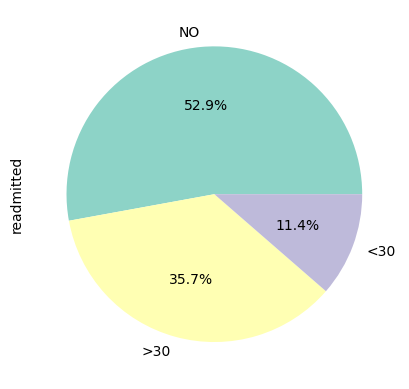

In [28]:
#Target value plot
diabetic['readmitted'].value_counts()/len(diabetic)
counts = diabetic['readmitted'].value_counts()

percentages = counts * 100 / len(diabetic)

fig, ax = plt.subplots()
colors = plt.cm.Set3.colors
percentages.sort_index(ascending=False).plot(kind='pie', ax=ax, autopct='%1.1f%%', colors=colors)

plt.show()

The goal of our study is to : "determine the early readmission of the patient within 30 days of discharge"
So, only the parameters <30 and No are interesting. We can transform >30 into a no.
Moreover, Since it is a binary response we'll convert our values into numeric values.

In [29]:
#target value 
diabetic = diabetic.replace({"NO":0,
                    "<30":1,
                    ">30":0})


print(diabetic.readmitted.value_counts())

0    88026
1    11314
Name: readmitted, dtype: int64


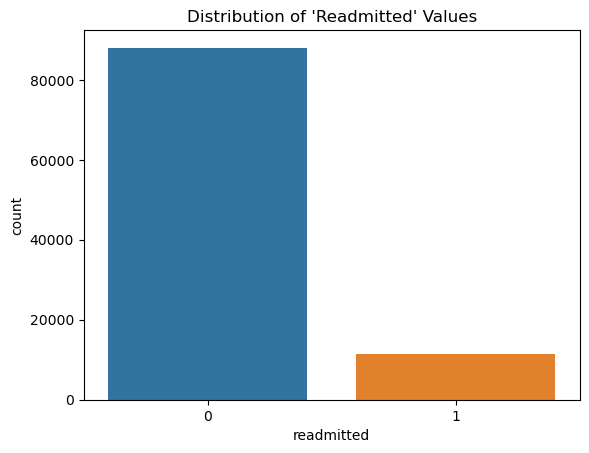

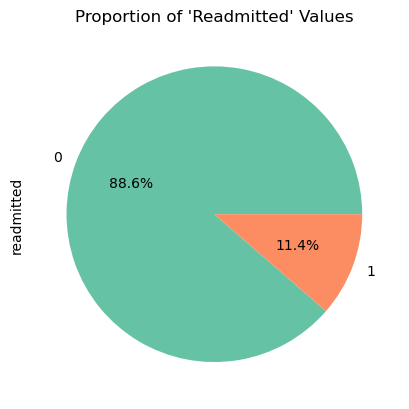

In [30]:
#target value distribution
sns.countplot(x = "readmitted", data = diabetic)
plt.title("Distribution of 'Readmitted' Values")
plt.show()

colors1 = plt.cm.Set2.colors
diabetic.readmitted.value_counts().plot.pie(autopct = "%.1f%%", colors=colors1)
plt.title("Proportion of 'Readmitted' Values")
plt.show()

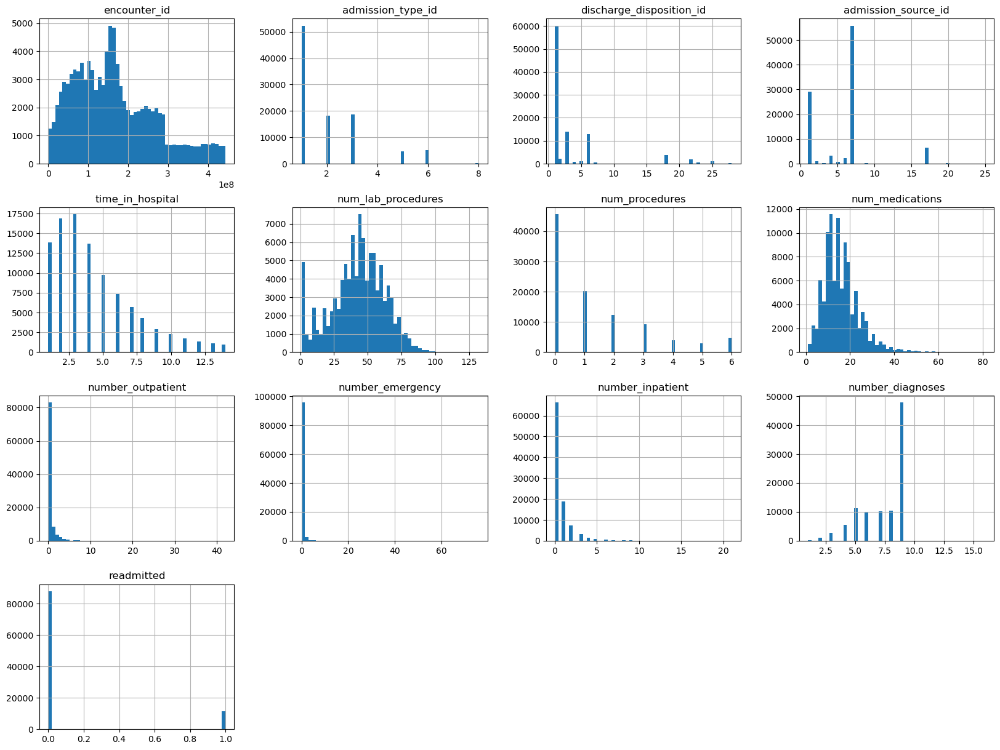

In [31]:
#Variables historigrams
diabetic.drop(["patient_nbr"],axis=1).hist(bins=50,figsize=(20,15))
plt.show()

In [32]:
diabetic['gender'].unique()

array(['Female', 'Male'], dtype=object)

In [33]:
#gender numerisation
diabetic = diabetic.replace({"Male":0,
                    "Female":1})


print(diabetic.gender.value_counts())

1    53454
0    45886
Name: gender, dtype: int64


## Correlations overview 

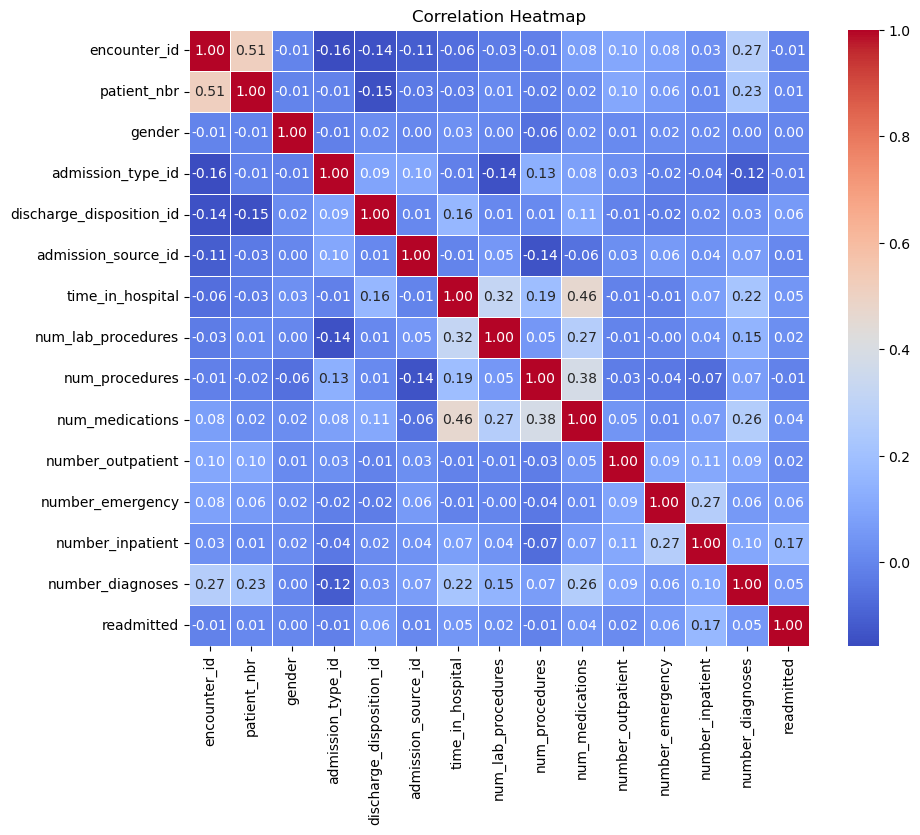

In [34]:
#correlation matrix
correlation_matrix = diabetic.corr(numeric_only=True)
#heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

We focus on the variables that make sense and that we will use 

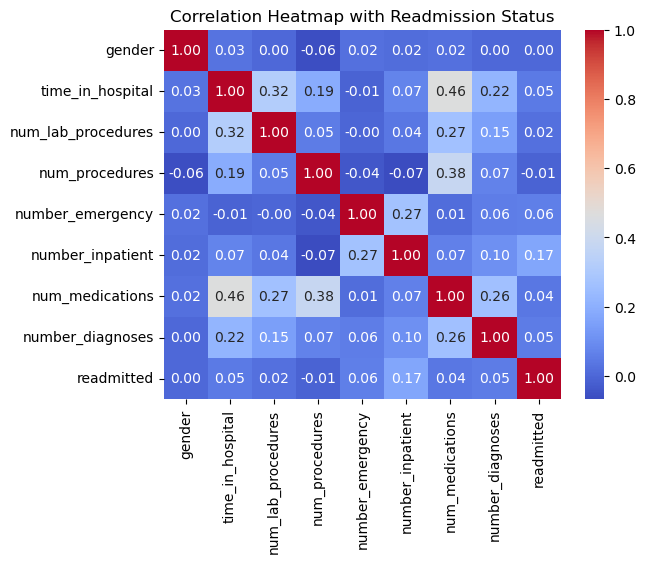

In [35]:
#correlatin matrix
selected_features = ['gender','time_in_hospital','num_lab_procedures','num_procedures','number_emergency', "number_inpatient", 'num_medications', 'number_diagnoses', 'readmitted']
correlation_matrix = diabetic[selected_features].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap with Readmission Status')
plt.show()

Gender has nothing to do with beign readmitted or not or with any other variable.
Correlations to explore :
time in hospital and num_medication, num_lab_procedure
num_procedure and num_medications
number_emergency and number_inpatient

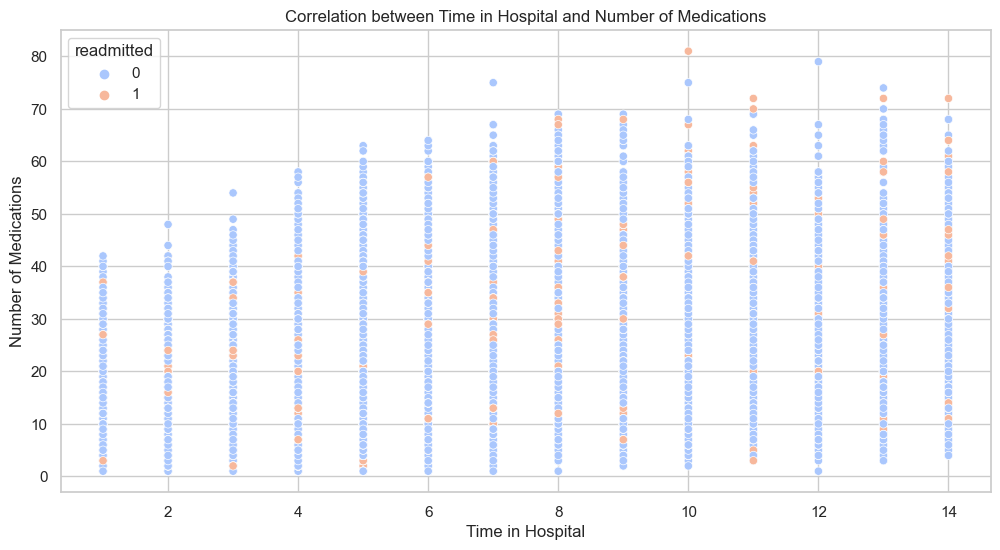

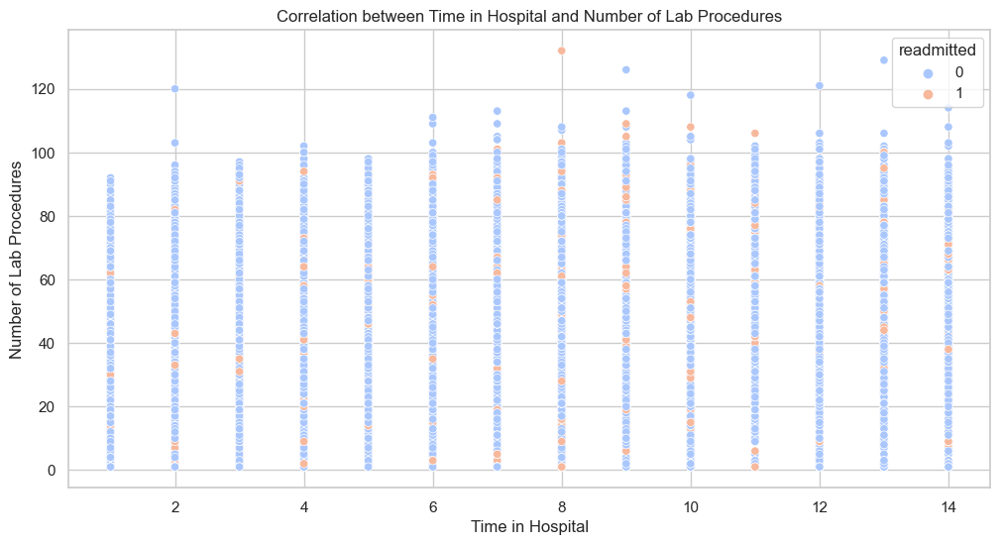

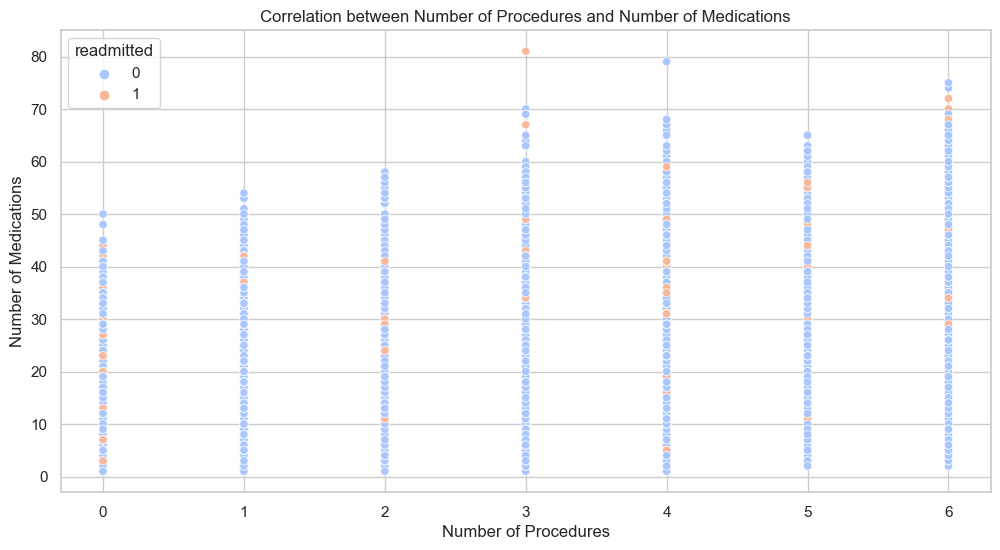

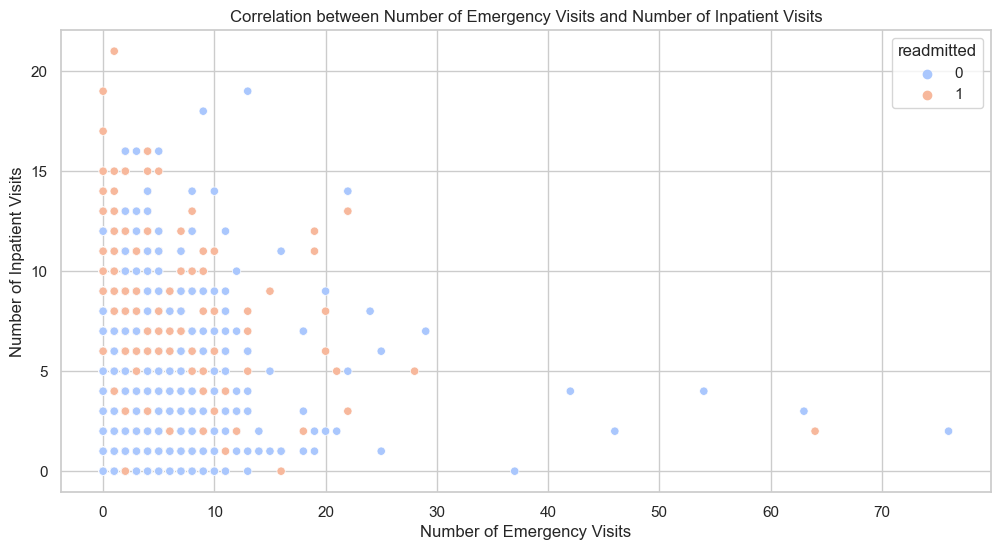

In [36]:

#Style
sns.set(style="whitegrid")

#Plot 1: Correlation between time_in_hospital and num_medications
plt.figure(figsize=(12, 6))
sns.scatterplot(x='time_in_hospital', y='num_medications', hue='readmitted', data=diabetic, palette='coolwarm')
plt.title('Correlation between Time in Hospital and Number of Medications')
plt.xlabel('Time in Hospital')
plt.ylabel('Number of Medications')
plt.show()

#Plot 2: Correlation between time_in_hospital and num_lab_procedures
plt.figure(figsize=(12, 6))
sns.scatterplot(x='time_in_hospital', y='num_lab_procedures', hue='readmitted', data=diabetic, palette='coolwarm')
plt.title('Correlation between Time in Hospital and Number of Lab Procedures')
plt.xlabel('Time in Hospital')
plt.ylabel('Number of Lab Procedures')
plt.show()

#Plot 3: Correlation between num_procedure and num_medications
plt.figure(figsize=(12, 6))
sns.scatterplot(x='num_procedures', y='num_medications', hue='readmitted', data=diabetic, palette='coolwarm')
plt.title('Correlation between Number of Procedures and Number of Medications')
plt.xlabel('Number of Procedures')
plt.ylabel('Number of Medications')
plt.show()

#Plot 4: Correlation between number_emergency and number_inpatient
plt.figure(figsize=(12, 6))
sns.scatterplot(x='number_emergency', y='number_inpatient', hue='readmitted', data=diabetic, palette='coolwarm')
plt.title('Correlation between Number of Emergency Visits and Number of Inpatient Visits')
plt.xlabel('Number of Emergency Visits')
plt.ylabel('Number of Inpatient Visits')
plt.show()


Plot 4 shows that : the more the patient has inpatient visits higher is the probability for the patient to be readmitted 

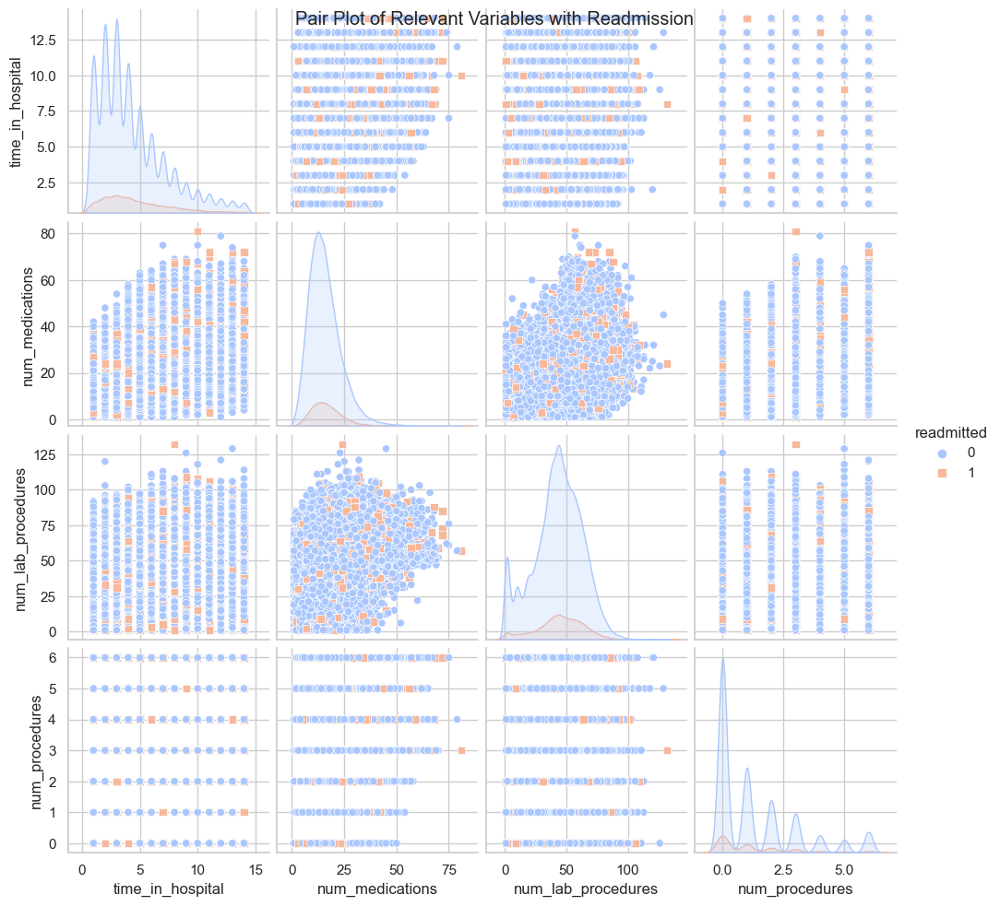

In [37]:

sns.set(style="whitegrid")


columns_to_plot = ['time_in_hospital', 'num_medications', 'num_lab_procedures', 'num_procedures', 'readmitted']
plot_data = diabetic[columns_to_plot]

# Pair plot
sns.pairplot(plot_data, hue='readmitted', palette='coolwarm', markers=["o", "s"])
plt.suptitle('Pair Plot of Relevant Variables with Readmission')
plt.show()


## Visualilizations of Target Variable and variables

In [38]:
#Count of Readmitted Cases by Race

fig = px.histogram(diabetic, x='race', color='readmitted', barmode='group', title='Count of Readmitted Cases by Race')
fig.show()

readmission status seems proportional

In [39]:
#count of readmitted cases by time in hospital

#cross-tabulation of readmitted cases by time in hospital
cross_tab = pd.crosstab(diabetic['time_in_hospital'], diabetic['readmitted'])

#bar chart for the count of readmitted cases by time in hospital
bar_chart = go.Bar(x=cross_tab.index, y=cross_tab[1], name='Readmitted', marker_color='red')
bar_chart_no = go.Bar(x=cross_tab.index, y=cross_tab[0], name='Not Readmitted', marker_color='blue')

data = [bar_chart, bar_chart_no]
layout = go.Layout(title='Count of Readmitted Cases by Time in Hospital',
                   xaxis=dict(title='Time in Hospital'),
                   yaxis=dict(title='Count'))

fig = go.Figure(data=data, layout=layout)
fig.show()

More time spent in hospital the less readmitted

In [40]:
#box plot of number of diagnoses by readmission status
fig = px.box(diabetic, x='readmitted', y='number_diagnoses', title='Box Plot of Number diagnonses by Readmission Status')
fig.show()

It seems that more diagnoses = more readmitted 

In [41]:
#box plot of number of lab procedures by readmission status
box_plot = go.Box(x=diabetic['readmitted'], y=diabetic['num_lab_procedures'], boxpoints='all', jitter=0.3, pointpos=-1.8)

data = [box_plot]
layout = go.Layout(title='Box Plot of Number of Lab Procedures by Readmission Status',
                   xaxis=dict(title='Readmission Status'),
                   yaxis=dict(title='Number of Lab Procedures'))

fig = go.Figure(data=data, layout=layout)
fig.show()

In [42]:
#Pair Plot of number of diagnoses and lab procedures by Readmission Status
variables = ['number_diagnoses', 'num_lab_procedures']
index_variable = 'number_diagnoses'
target_variable = 'readmitted'

group_labels = diabetic[target_variable].unique()
scatter_matrix = ff.create_scatterplotmatrix(
    diabetic[variables], diag='histogram', index_vals=diabetic[index_variable],
    colormap='Viridis', colormap_type='cat', height=700, width=700
)

# Assign colors based on group labels
colors = {group_labels[0]: 'blue', group_labels[1]: 'red'}

for i in range(len(scatter_matrix['data'])):
    scatter_matrix['data'][i]['marker']['color'] = [colors[val] for val in diabetic[target_variable]]

scatter_matrix.update_layout(title='Pair Plot of number of diagnoses and lab procedures by Readmission Status', title_x=0.5)
scatter_matrix.show()


#New Variable

In [43]:
diabetic['total_procedures_medications'] = diabetic['num_procedures'] + diabetic['num_medications']

In [44]:

fig = px.histogram(diabetic, x='total_procedures_medications', color='readmitted',
                   labels={'total_procedures_medications': 'Total Procedures/Medications'},
                   title='Distribution of Total Procedures/Medications by Readmission Status')

fig.show()


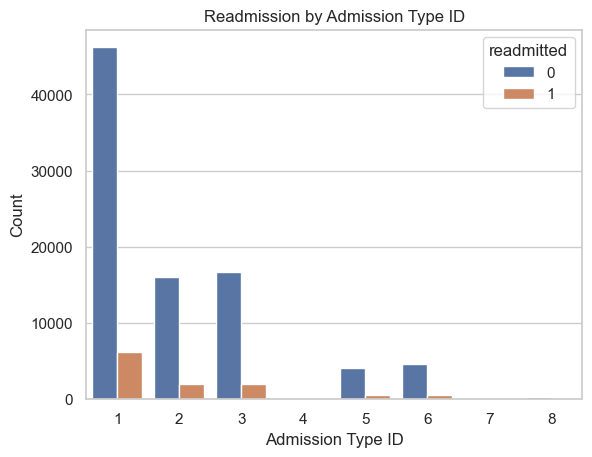

In [45]:

sns.countplot(x='admission_type_id', hue='readmitted', data=diabetic)
plt.title('Readmission by Admission Type ID')
plt.xlabel('Admission Type ID')
plt.ylabel('Count')
plt.show()


4,7,8 never readmitted

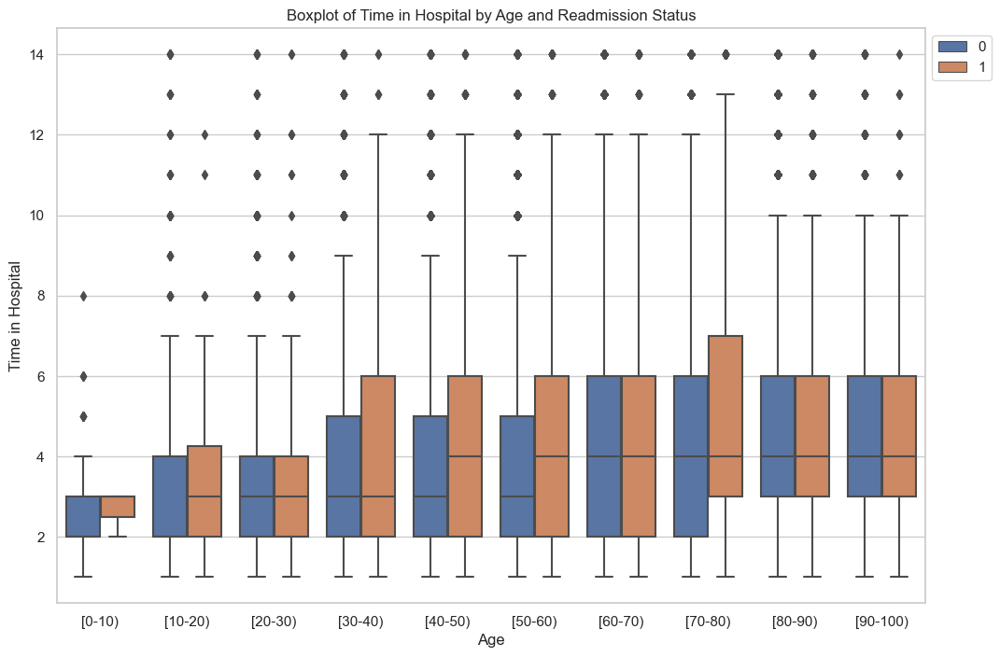

In [46]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'readmitted' is a binary variable (0 or 1)
sns.set(style="whitegrid")
plt.figure(figsize=(12, 8))

# Adjusting plot width
sns.boxplot(x='age', y='time_in_hospital', hue='readmitted', data=diabetic)
plt.title('Boxplot of Time in Hospital by Age and Readmission Status')
plt.xlabel('Age')
plt.ylabel('Time in Hospital')

# Moving the legend to the right
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

plt.show()


Bokeh visualization 
The more the patient is at hospital the more mediaction he has 

In [110]:
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource, HoverTool
from bokeh.palettes import Viridis256
from bokeh.transform import linear_cmap

# Select relevant columns
selected_columns = ['time_in_hospital', 'num_medications', 'readmitted']

# Create a ColumnDataSource
source = ColumnDataSource(diabetic[selected_columns])

# Define color map
mapper = linear_cmap(field_name='readmitted', palette=Viridis256, low=min(diabetic['readmitted']), high=max(diabetic['readmitted']))

# Create the scatter plot
plot = figure(width=800, height=600, title='Scatter Plot of Time in Hospital vs. Number of Medications',
              x_axis_label='Time in Hospital', y_axis_label='Number of Medications')

scatter = plot.circle('time_in_hospital', 'num_medications', size=10, source=source, color=mapper, legend_field='readmitted', alpha=0.6)

# Add hover tool
hover = HoverTool()
hover.tooltips = [('Time in Hospital', '@time_in_hospital'), ('Number of Medications', '@num_medications'), ('Readmitted', '@readmitted')]
plot.add_tools(hover)

# Add legend
plot.legend.title = 'Readmitted'
plot.legend.label_text_font_size = '10px'

# Show the plot
show(plot)


# III- Modeling and Predictions

In [111]:
diabetic.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99340 entries, 0 to 101765
Data columns (total 32 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   encounter_id                  99340 non-null  int64 
 1   patient_nbr                   99340 non-null  int64 
 2   race                          99340 non-null  object
 3   gender                        99340 non-null  int64 
 4   age                           99340 non-null  object
 5   admission_type_id             99340 non-null  int64 
 6   discharge_disposition_id      99340 non-null  int64 
 7   admission_source_id           99340 non-null  int64 
 8   time_in_hospital              99340 non-null  int64 
 9   num_lab_procedures            99340 non-null  int64 
 10  num_procedures                99340 non-null  int64 
 11  num_medications               99340 non-null  int64 
 12  number_outpatient             99340 non-null  int64 
 13  number_emergenc

In [76]:
readmitted_counts = diabetic['readmitted'].value_counts()

# Create a bar chart for the distribution of values in the 'readmitted' column
bar_chart = go.Bar(x=readmitted_counts.index, y=readmitted_counts.values)
layout = go.Layout(title='Distribution of "Readmitted" Values',
                   xaxis=dict(title='Readmitted Value'),
                   yaxis=dict(title='Number of Patients'))
fig = go.Figure(data=[bar_chart], layout=layout)
fig.show()

In [38]:
def categorize_diagnosis(value):
    if pd.isnull(value):
        return value  # Leave null values as they are
    elif isinstance(value, str):
        try:
            value = float(value)  # Convert float strings to float
            if np.isnan(value):   # Leave NaN values as they are
                return value
            for (start, end), category in {
                (1, 139): 'Infectious and Parasitic Diseases',
                (140, 239): 'Neoplasms',
                (240, 279): 'Endocrine, Nutritional and Metabolic Diseases, and Immunity Disorders',
                (280, 289): 'Diseases of the Blood and Blood-Forming Organs',
                (290, 319): 'Mental Disorders',
                (320, 389): 'Diseases of the Nervous System and Sense Organs',
                (390, 459): 'Diseases of the Circulatory System',
                (460, 519): 'Diseases of the Respiratory System',
                (520, 579): 'Diseases of the Digestive System',
                (580, 629): 'Diseases of the Genitourinary System',
                (630, 679): 'Complications of Pregnancy, Childbirth, and the Puerperium',
                (680, 709): 'Diseases of the Skin and Subcutaneous Tissue',
                (710, 739): 'Diseases of the Musculoskeletal System and Connective Tissue',
                (740, 759): 'Congenital Anomalies',
                (760, 779): 'Certain Conditions Originating in the Perinatal Period',
                (780, 799): 'Symptoms, Signs, and Ill-Defined Conditions',
                (800, 999): 'Injury and Poisoning'
            }.items():
                if start <= value <= end:
                    return category
        except ValueError:
            return 'External Causes of Injury and Supplemental Classification'

    return value  # Return the original value if it doesn't match any category

# Example usage
import pandas as pd

# Assuming you have a DataFrame called 'df' with columns 'diag_1', 'diag_2', and 'diag_3'
diabetic['diag_1_category'] = diabetic['diag_1'].apply(categorize_diagnosis)
diabetic['diag_2_category'] = diabetic['diag_2'].apply(categorize_diagnosis)
diabetic['diag_3_category'] = diabetic['diag_3'].apply(categorize_diagnosis)
diabetic= pd.get_dummies(diabetic, columns=['diag_1_category', 'diag_2_category', 'diag_3_category'])   #  ca ca fait qu'on a pas besoin de gerer les NaN c'est cool pas de prediction a faire en plus jsp si ca vous va (ça me va)



In [39]:
for column in diabetic.columns:
    null_count = diabetic[column].isnull().sum()
    print(null_count)

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
358
1423
0
96417
84745
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


In [40]:
nan_rows_count = diabetic[['diag_1', 'diag_2', 'diag_3']].isnull().any(axis=1).sum()

print(f"Number of rows with NaN in diag_1, diag_2, or diag_3: {nan_rows_count}")


Number of rows with NaN in diag_1, diag_2, or diag_3: 1522


In [41]:
diabetic=pd.get_dummies(diabetic, columns=['race'])

In [42]:
diabetic['age'] = diabetic['age'].replace({
    '[0-10)': 0,
    '[10-20)': 1,
    '[20-30)': 2,
    '[30-40)': 3,
    '[40-50)': 4,
    '[50-60)': 5,
    '[60-70)': 6,
    '[70-80)': 7,
    '[80-90)': 8,
    '[90-100)': 9
})

In [43]:
count= diabetic['admission_type_id'].value_counts()[[5,6,8]]
count

admission_type_id
5    4785
6    5291
8     320
Name: count, dtype: int64

In [44]:
diabetic['admission_type_id']

0         6
1         1
2         1
3         1
4         1
         ..
101761    1
101762    1
101763    1
101764    2
101765    1
Name: admission_type_id, Length: 101763, dtype: int64

In [45]:
diabetic['admission_type_id'] = diabetic['admission_type_id'].replace([5, 6, 8], 0) #0 ou -10 jsp
diabetic['admission_type_id'] = diabetic['admission_type_id'].replace({4: 10, 3: 20, 2: 30, 1: 40, 7: 50}) #changer l'orde du moins grave 4 : newborn par 10, au plus grave 7 : par 14

In [46]:
#discharge mapping, order 

diabetic['discharge_disposition_id'] = diabetic['discharge_disposition_id'].replace({
    18: 0,
    25 : 0,
    26 : 0,
    6 : 1,
    1 : 2,
    27 : 3,
    15 : 4,
    22 : 5,
    2 : 6,
    28 : 7,
    30 : 8,
    4: 9,
    23 : 10,
    24 : 11,
    3 : 12,
    8 : 13,
    7 : 14,
    5: 15,
    9 : 16,
    10: 17,
    12 : 18,
    16 : 19,
    17 : 20,
    29 : 21
})

In [47]:
#admission source mapping 


diabetic['admission_source_id'] = diabetic['admission_source_id'].replace({
    9: 0,
    15: 0,
    21: 0,
    17: 0,
    20: 0,
    27: 0,
    23: 1,
    24: 1,
    11: 2,
    12: 3,
    13: 4,
    14: 5,
    8: 6,
    1: 7,
    2: 8,
    18: 9,
    3: 10,
    25: 11,
    6: 12,
    22: 13,
    4: 14,
    26: 15,
    19: 16,
    5: 17,
    7: 18,
    10: 19
})


In [48]:
def replace_meds(df, column_list):
    for column in column_list:
        df[column] = df[column].replace({'No': 0, 'Down': 1, 'Steady': 2, 'Up': 3})
    return df

In [49]:
pd.set_option('display.max_columns', None)

In [50]:
replace_meds(diabetic, ['metformin','glimepiride','glipizide','glyburide','pioglitazone','rosiglitazone','insulin'])

,encounter_id,patient_nbr,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,diag_1,diag_2,diag_3,number_diagnoses,max_glu_serum,A1Cresult,metformin,glimepiride,glipizide,glyburide,pioglitazone,rosiglitazone,insulin,change,diabetesMed,readmitted,"diag_1_category_Complications of Pregnancy, Childbirth, and the Puerperium",diag_1_category_Congenital Anomalies,diag_1_category_Diseases of the Blood and Blood-Forming Organs,diag_1_category_Diseases of the Circulatory System,diag_1_category_Diseases of the Digestive System,diag_1_category_Diseases of the Genitourinary System,diag_1_category_Diseases of the Musculoskeletal System and Connective Tissue,diag_1_category_Diseases of the Nervous System and Sense Organs,diag_1_category_Diseases of the Respiratory System,diag_1_category_Diseases of the Skin and Subcutaneous Tissue,"diag_1_category_Endocrine, Nutritional and Metabolic Diseases, and Immunity Disorders",diag_1_category_External Causes of Injury and Supplemental Classification,diag_1_category_Infectious and Parasitic Diseases,diag_1_category_Injury and Poisoning,diag_1_category_Mental Disorders,diag_1_category_Neoplasms,"diag_1_category_Symptoms, Signs, and Ill-Defined Conditions","diag_2_category_Complications of Pregnancy, Childbirth, and the Puerperium",diag_2_category_Congenital Anomalies,diag_2_category_Diseases of the Blood and Blood-Forming Organs,diag_2_category_Diseases of the Circulatory System,diag_2_category_Diseases of the Digestive System,diag_2_category_Diseases of the Genitourinary System,diag_2_category_Diseases of the Musculoskeletal System and Connective Tissue,diag_2_category_Diseases of the Nervous System and Sense Organs,diag_2_category_Diseases of the Respiratory System,diag_2_category_Diseases of the Skin and Subcutaneous Tissue,"diag_2_category_Endocrine, Nutritional and Metabolic Diseases, and Immunity Disorders",diag_2_category_External Causes of Injury and Supplemental Classification,diag_2_category_Infectious and Parasitic Diseases,diag_2_category_Injury and Poisoning,diag_2_category_Mental Disorders,diag_2_category_Neoplasms,"diag_2_category_Symptoms, Signs, and Ill-Defined Conditions","diag_3_category_Complications of Pregnancy, Childbirth, and the Puerperium",diag_3_category_Congenital Anomalies,diag_3_category_Diseases of the Blood and Blood-Forming Organs,diag_3_category_Diseases of the Circulatory System,diag_3_category_Diseases of the Digestive System,diag_3_category_Diseases of the Genitourinary System,diag_3_category_Diseases of the Musculoskeletal System and Connective Tissue,diag_3_category_Diseases of the Nervous System and Sense Organs,diag_3_category_Diseases of the Respiratory System,diag_3_category_Diseases of the Skin and Subcutaneous Tissue,"diag_3_category_Endocrine, Nutritional and Metabolic Diseases, and Immunity Disorders",diag_3_category_External Causes of Injury and Supplemental Classification,diag_3_category_Infectious and Parasitic Diseases,diag_3_category_Injury and Poisoning,diag_3_category_Mental Disorders,diag_3_category_Neoplasms,"diag_3_category_Symptoms, Signs, and Ill-Defined Conditions",race_AfricanAmerican,race_Asian,race_Caucasian,race_Hispanic,race_Other
0,2278392,8222157,Female,0,0,0,7,1,41,0,1,0,0,0,250.83,NaN,NaN,1,NaN,NaN,0,0,0,0,0,0,0,No,No,NO,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False
1,149190,55629189,Female,1,40,2,18,3,59,0,18,0,0,0,276,250.01,255,9,NaN,NaN,0,0,0,0,0,0,3,Ch,Yes,>30,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,F

In [51]:

diabetic['max_glu_serum']= diabetic['max_glu_serum'].replace({

    'None' : 0,
    'Norm': 10,
    '>200': 20,
    '>300': 30})
diabetic['max_glu_serum'].fillna(0, inplace=True)

In [52]:
diabetic['A1Cresult']= diabetic['A1Cresult'].replace({

    'None' : 0,
    'Norm': 10,
    '>7': 20,
    '>8': 30
}
)
diabetic['A1Cresult'].fillna(0, inplace=True)

In [53]:
diabetic['diabetesMed']=diabetic['diabetesMed'].replace({'Yes': True, 'No': False})

In [54]:
diabetic['change']=diabetic['change'].replace({'Ch': True, 'No': False})

In [55]:
for i in diabetic.columns:
    print(i+'\n')

encounter_id

patient_nbr

gender

age

admission_type_id

discharge_disposition_id

admission_source_id

time_in_hospital

num_lab_procedures

num_procedures

num_medications

number_outpatient

number_emergency

number_inpatient

diag_1

diag_2

diag_3

number_diagnoses

max_glu_serum

A1Cresult

metformin

glimepiride

glipizide

glyburide

pioglitazone

rosiglitazone

insulin

change

diabetesMed

readmitted

diag_1_category_Complications of Pregnancy, Childbirth, and the Puerperium

diag_1_category_Congenital Anomalies

diag_1_category_Diseases of the Blood and Blood-Forming Organs

diag_1_category_Diseases of the Circulatory System

diag_1_category_Diseases of the Digestive System

diag_1_category_Diseases of the Genitourinary System

diag_1_category_Diseases of the Musculoskeletal System and Connective Tissue

diag_1_category_Diseases of the Nervous System and Sense Organs

diag_1_category_Diseases of the Respiratory System

diag_1_category_Diseases of the Skin and Subcutaneous 

In [56]:
diabetic = diabetic.drop(['diag_1', 'diag_2', 'diag_3'], axis=1)

# Classification models

## Working with the imbalanced dataset

In [62]:
from sklearn.model_selection import train_test_split

X = diabetic.drop('readmitted', axis=1)
Y=diabetic['readmitted']

x_train, x_test, y_train, y_test = train_test_split(X,Y, test_size = 0.3, random_state=10)

In [63]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(x_train)
x_train= scaler.transform(x_train)
x_test= scaler.transform(x_test)


### Logistic Regression

In [39]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, recall_score, confusion_matrix, precision_score, f1_score

lg= LogisticRegression()
lg.fit(x_train, y_train)
y_pred_lg = lg.predict(x_test)

report = classification_report(y_test, y_pred_lg)
cm=confusion_matrix(y_test, y_pred_lg)
recall = recall_score(y_test, y_pred_lg)
precision = precision_score(y_test, y_pred_lg)
f1 = f1_score(y_test, y_pred_lg)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       0.89      1.00      0.94     26427
           1       0.43      0.01      0.03      3375

    accuracy                           0.89     29802
   macro avg       0.66      0.51      0.48     29802
weighted avg       0.84      0.89      0.84     29802
 [[26368    59]
 [ 3330    45]]
Recall: 0.013333333333333334
Precision: 0.4326923076923077
F1 Score: 0.025869502730669736


As the dataset is umbalanced, we can see that he isn't good at classifying the 1.

### Logistic Regression avec GridSearch

In [40]:
from sklearn.model_selection import GridSearchCV
lg_params = {
    'penalty': ['l1', 'l2'],
    'C': [0.1, 1, 10],
    'solver': ['liblinear', 'saga'],
}

grid_search_lg = GridSearchCV(lg, lg_params, cv=2, n_jobs=-1, scoring='roc_auc', verbose=10)
grid_search_lg.fit(x_train, y_train)

print(grid_search_lg.best_score_)
print(grid_search_lg.best_params_)

Fitting 2 folds for each of 12 candidates, totalling 24 fits
0.6461859650012327
{'C': 0.1, 'penalty': 'l1', 'solver': 'liblinear'}


In [41]:
y_pred_lg= grid_search_lg.predict(x_test)
report = classification_report(y_test, y_pred_lg)
cm=confusion_matrix(y_test, y_pred_lg)
recall = recall_score(y_test, y_pred_lg)
precision = precision_score(y_test, y_pred_lg)
f1 = f1_score(y_test, y_pred_lg)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       0.89      1.00      0.94     26427
           1       0.45      0.01      0.03      3375

    accuracy                           0.89     29802
   macro avg       0.67      0.51      0.48     29802
weighted avg       0.84      0.89      0.84     29802
 [[26370    57]
 [ 3329    46]]
Recall: 0.01362962962962963
Precision: 0.44660194174757284
F1 Score: 0.02645198389879241


on voit que c'est mieux mais la precision à beaucoup diminué et maintenant il fait beaucoup d'erreurs sur les FP.

Toutefois,dans le contexte de l'hopital, on prefere avoir plus de FP que de FN pour des raisons de sécurité.

### KNN

In [97]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(x_train, y_train)
y_pred_knn = knn.predict(x_test)


report = classification_report(y_test, y_pred_knn)
cm=confusion_matrix(y_test, y_pred_knn)
recall = recall_score(y_test, y_pred_knn)
precision = precision_score(y_test, y_pred_knn)
f1 = f1_score(y_test, y_pred_knn)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       0.89      0.99      0.93     26427
           1       0.21      0.03      0.05      3375

    accuracy                           0.88     29802
   macro avg       0.55      0.51      0.49     29802
weighted avg       0.81      0.88      0.83     29802
 [[26058   369]
 [ 3278    97]]
Recall: 0.02874074074074074
Precision: 0.20815450643776823
F1 Score: 0.05050768029159074


In [98]:
knn = KNeighborsClassifier()
knn_params = {
    'n_neighbors': [3, 5, 7],
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree'],
}

grid_search_knn = GridSearchCV(knn, knn_params, cv=2, n_jobs=-1, scoring='roc_auc', verbose=10)
grid_search_knn.fit(x_train, y_train)

print(grid_search_knn.best_score_)
print(grid_search_knn.best_params_)

Fitting 2 folds for each of 12 candidates, totalling 24 fits
0.5514742244771302
{'algorithm': 'auto', 'n_neighbors': 7, 'weights': 'distance'}


In [99]:
y_pred_knn= grid_search_knn.predict(x_test)
report = classification_report(y_test, y_pred_knn)
cm=confusion_matrix(y_test, y_pred_knn)
recall = recall_score(y_test, y_pred_knn)
precision = precision_score(y_test, y_pred_knn)
f1 = f1_score(y_test, y_pred_knn)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       0.89      0.99      0.94     26427
           1       0.24      0.02      0.03      3375

    accuracy                           0.88     29802
   macro avg       0.57      0.51      0.48     29802
weighted avg       0.81      0.88      0.84     29802
 [[26247   180]
 [ 3317    58]]
Recall: 0.017185185185185185
Precision: 0.24369747899159663
F1 Score: 0.032106282867423196


### Random Forest Classifier

In [44]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier()
rf.fit(x_train, y_train)
y_pred_rf = rf.predict(x_test)

report = classification_report(y_test, y_pred_lg)
cm=confusion_matrix(y_test, y_pred_lg)
recall = recall_score(y_test, y_pred_lg)
precision = precision_score(y_test, y_pred_lg)
f1 = f1_score(y_test, y_pred_lg)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       0.89      1.00      0.94     26427
           1       0.45      0.01      0.03      3375

    accuracy                           0.89     29802
   macro avg       0.67      0.51      0.48     29802
weighted avg       0.84      0.89      0.84     29802
 [[26370    57]
 [ 3329    46]]
Recall: 0.01362962962962963
Precision: 0.44660194174757284
F1 Score: 0.02645198389879241


In [45]:
rf_params = {
    'n_estimators': [150, 200, 250],
   # 'criterion': ['gini', 'entropy'],
    'max_depth': [7,10, 13],
   # 'min_samples_split': [ 10,15,20],
   #'min_samples_leaf': [ 6,8, 10],
    'max_features': ['sqrt', 'log2'],
    'max_samples': [0.5, 0.8, 1,1],
    'class_weight': ['balanced'] ,
    #'bootstrap': [True, False],
    
  
}
grid_search_p = GridSearchCV(rf, rf_params, cv=2, n_jobs=-1, scoring = 'roc_auc', verbose=10).fit(x_train, y_train)
print(grid_search_p.best_score_)
print(grid_search_p.best_params_)

Fitting 2 folds for each of 72 candidates, totalling 144 fits
0.661530892689788
{'class_weight': 'balanced', 'max_depth': 7, 'max_features': 'sqrt', 'max_samples': 0.5, 'n_estimators': 250}


In [46]:
y_pred_rf= grid_search_p.predict(x_test)
report = classification_report(y_test, y_pred_rf)
cm=confusion_matrix(y_test, y_pred_rf)
recall = recall_score(y_test, y_pred_rf)
precision = precision_score(y_test, y_pred_rf)
f1 = f1_score(y_test, y_pred_rf)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       0.92      0.66      0.77     26427
           1       0.18      0.57      0.27      3375

    accuracy                           0.65     29802
   macro avg       0.55      0.62      0.52     29802
weighted avg       0.84      0.65      0.72     29802
 [[17542  8885]
 [ 1457  1918]]
Recall: 0.5682962962962963
Precision: 0.1775432750161992
F1 Score: 0.2705600225701792


### Balanced Random Forest Classifier

In [212]:
from imblearn.ensemble import BalancedRandomForestClassifier

rf=BalancedRandomForestClassifier()
rf.fit(x_train, y_train)
y_pred_rf = rf.predict(x_test)


report = classification_report(y_test, y_pred_rf)
cm=confusion_matrix(y_test, y_pred_rf)
recall = recall_score(y_test, y_pred_rf)
precision = precision_score(y_test, y_pred_rf)
f1 = f1_score(y_test, y_pred_rf)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

C:\Users\Izard\anaconda3\envs\PythonForDataAnalysis\lib\site-packages\imblearn\ensemble\_forest.py:546: FutureWarning:

The default of `sampling_strategy` will change from `'auto'` to `'all'` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `'all'` to silence this warning and adopt the future behaviour.

C:\Users\Izard\anaconda3\envs\PythonForDataAnalysis\lib\site-packages\imblearn\ensemble\_forest.py:558: FutureWarning:

The default of `replacement` will change from `False` to `True` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `True` to silence this warning and adopt the future behaviour.



              precision    recall  f1-score   support

           0       0.92      0.63      0.75     26427
           1       0.17      0.60      0.26      3375

    accuracy                           0.62     29802
   macro avg       0.55      0.61      0.51     29802
weighted avg       0.84      0.62      0.69     29802
 [[16576  9851]
 [ 1364  2011]]
Recall: 0.5958518518518519
Precision: 0.1695329624009442
F1 Score: 0.2639627223206668


In [213]:

rf = BalancedRandomForestClassifier()
rf_params = {
    'n_estimators': [150, 200, 250],
       #'criterion': ['gini', 'entropy'],
    'max_depth': [7,10, 13],
       #'min_samples_split': [ 10,15,20],
       #'min_samples_leaf': [ 6,8, 10],
    'max_features': ['sqrt', 'log2'],
    'max_samples': [0.5, 0.8, 1,1],
        #'bootstrap': [True, False],
  
}
grid_search_p = GridSearchCV(rf, rf_params, cv=2, n_jobs=-1, scoring = 'roc_auc', verbose=10).fit(x_train, y_train)
print(grid_search_p.best_score_)
print(grid_search_p.best_params_)

Fitting 2 folds for each of 72 candidates, totalling 144 fits


C:\Users\Izard\anaconda3\envs\PythonForDataAnalysis\lib\site-packages\imblearn\ensemble\_forest.py:546: FutureWarning:

The default of `sampling_strategy` will change from `'auto'` to `'all'` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `'all'` to silence this warning and adopt the future behaviour.

C:\Users\Izard\anaconda3\envs\PythonForDataAnalysis\lib\site-packages\imblearn\ensemble\_forest.py:558: FutureWarning:

The default of `replacement` will change from `False` to `True` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `True` to silence this warning and adopt the future behaviour.



0.6623322013585501
{'max_depth': 13, 'max_features': 'sqrt', 'max_samples': 0.8, 'n_estimators': 200}


In [214]:
y_pred_rf= grid_search_p.predict(x_test)
report = classification_report(y_test, y_pred_rf)
cm=confusion_matrix(y_test, y_pred_rf)
recall = recall_score(y_test, y_pred_rf)
precision = precision_score(y_test, y_pred_rf)
f1 = f1_score(y_test, y_pred_rf)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       0.93      0.60      0.73     26427
           1       0.17      0.63      0.26      3375

    accuracy                           0.61     29802
   macro avg       0.55      0.61      0.50     29802
weighted avg       0.84      0.61      0.68     29802
 [[15982 10445]
 [ 1265  2110]]
Recall: 0.6251851851851852
Precision: 0.1680605336519315
F1 Score: 0.26490897677338354


(0.0, 2.0)

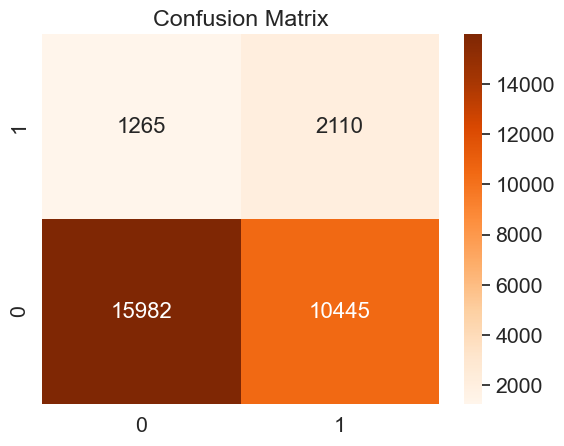

In [223]:
cm_df = pd.DataFrame(
    confusion_matrix(y_test, y_pred_rf),
    columns=grid_search_p.classes_,
    index=grid_search_p.classes_
)

sns.set(font_scale=1.4) # for label size
sns.heatmap(
    cm_df, annot=True, annot_kws={"size": 16},
    cmap='Oranges', fmt='d'
    
)

plt.title('Confusion Matrix')
plt.xlim(0, 2)
plt.ylim(0, 2)

### Balanced Bagging Classifier

In [224]:
from imblearn.ensemble import BalancedBaggingClassifier

bbc=BalancedRandomForestClassifier()
rf.fit(x_train, y_train)
y_pred_bbc = rf.predict(x_test)


report = classification_report(y_test, y_pred_bbc)
cm=confusion_matrix(y_test, y_pred_bbc)
recall = recall_score(y_test, y_pred_bbc)
precision = precision_score(y_test, y_pred_bbc)
f1 = f1_score(y_test, y_pred_bbc)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

C:\Users\Izard\anaconda3\envs\PythonForDataAnalysis\lib\site-packages\imblearn\ensemble\_forest.py:546: FutureWarning:

The default of `sampling_strategy` will change from `'auto'` to `'all'` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `'all'` to silence this warning and adopt the future behaviour.

C:\Users\Izard\anaconda3\envs\PythonForDataAnalysis\lib\site-packages\imblearn\ensemble\_forest.py:558: FutureWarning:

The default of `replacement` will change from `False` to `True` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `True` to silence this warning and adopt the future behaviour.



              precision    recall  f1-score   support

           0       0.92      0.63      0.75     26427
           1       0.17      0.59      0.26      3375

    accuracy                           0.63     29802
   macro avg       0.55      0.61      0.51     29802
weighted avg       0.84      0.63      0.70     29802
 [[16679  9748]
 [ 1372  2003]]
Recall: 0.5934814814814815
Precision: 0.17045357841885797
F1 Score: 0.26484199391775753


In [225]:

rf_params = {
    'n_estimators': [150, 200, 250],
    'max_depth': [7, 10, 13],
    'max_features': ['sqrt', 'log2'],
    'max_samples': [0.5, 0.8, 1],

}

grid_search_bbc = GridSearchCV(bbc, rf_params, cv=2, n_jobs=-1, scoring='roc_auc', verbose=10).fit(x_train, y_train)

print(grid_search_bbc.best_score_)
print(grid_search_bbc.best_params_)

Fitting 2 folds for each of 54 candidates, totalling 108 fits


C:\Users\Izard\anaconda3\envs\PythonForDataAnalysis\lib\site-packages\imblearn\ensemble\_forest.py:546: FutureWarning:

The default of `sampling_strategy` will change from `'auto'` to `'all'` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `'all'` to silence this warning and adopt the future behaviour.

C:\Users\Izard\anaconda3\envs\PythonForDataAnalysis\lib\site-packages\imblearn\ensemble\_forest.py:558: FutureWarning:

The default of `replacement` will change from `False` to `True` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `True` to silence this warning and adopt the future behaviour.



0.6621055554210042
{'max_depth': 13, 'max_features': 'sqrt', 'max_samples': 0.5, 'n_estimators': 200}


In [226]:
y_pred_bbc= grid_search_p.predict(x_test)
report = classification_report(y_test, y_pred_bbc)
cm=confusion_matrix(y_test, y_pred_bbc)
recall = recall_score(y_test, y_pred_bbc)
precision = precision_score(y_test, y_pred_bbc)
f1 = f1_score(y_test, y_pred_bbc)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       0.93      0.60      0.73     26427
           1       0.17      0.63      0.26      3375

    accuracy                           0.61     29802
   macro avg       0.55      0.61      0.50     29802
weighted avg       0.84      0.61      0.68     29802
 [[15982 10445]
 [ 1265  2110]]
Recall: 0.6251851851851852
Precision: 0.1680605336519315
F1 Score: 0.26490897677338354


### Gradient Boosting Classifier

In [104]:
from sklearn.ensemble import GradientBoostingClassifier

gbc = GradientBoostingClassifier()
gbc.fit(x_train, y_train)
y_pred_gbc = gbc.predict(x_test)

report = classification_report(y_test, y_pred_gbc)
cm = confusion_matrix(y_test, y_pred_gbc)
recall = recall_score(y_test, y_pred_gbc)
precision = precision_score(y_test, y_pred_gbc)
f1 = f1_score(y_test, y_pred_gbc)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)


              precision    recall  f1-score   support

           0       0.89      1.00      0.94     26427
           1       0.59      0.01      0.02      3375

    accuracy                           0.89     29802
   macro avg       0.74      0.50      0.48     29802
weighted avg       0.85      0.89      0.84     29802
 [[26402    25]
 [ 3339    36]]
Recall: 0.010666666666666666
Precision: 0.5901639344262295
F1 Score: 0.0209545983701979


In [105]:
gbc_params = {
    'learning_rate': [0.1, 0.5, 1],
    'n_estimators': [ 200, 350,500],
    'max_depth': [3, 5, 10],
}

grid_search_gbc = GridSearchCV(gbc, gbc_params, cv=2, n_jobs=-1, scoring='roc_auc', verbose=10)
grid_search_gbc.fit(x_train, y_train)

print(grid_search_gbc.best_score_)
print(grid_search_gbc.best_params_)

Fitting 2 folds for each of 27 candidates, totalling 54 fits
0.6689080439269899
{'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}


In [106]:
y_pred_gbc= grid_search_p.predict(x_test)
report = classification_report(y_test, y_pred_gbc)
cm=confusion_matrix(y_test, y_pred_gbc)
recall = recall_score(y_test, y_pred_gbc)
precision = precision_score(y_test, y_pred_gbc)
f1 = f1_score(y_test, y_pred_gbc)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       0.92      0.66      0.77     26427
           1       0.18      0.57      0.27      3375

    accuracy                           0.65     29802
   macro avg       0.55      0.62      0.52     29802
weighted avg       0.84      0.65      0.72     29802
 [[17542  8885]
 [ 1457  1918]]
Recall: 0.5682962962962963
Precision: 0.1775432750161992
F1 Score: 0.2705600225701792


## Balanced Dataset but overfited

In [55]:
from sklearn.utils import resample
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

X = diabetic.drop('readmitted', axis=1)
Y = diabetic['readmitted']

x_train, x_test_true, y_train, y_test_true = train_test_split(X,Y, test_size = 0.25, random_state=10)
df = pd.concat([x_train, y_train], axis=1)

# Separate majority and minority classes
df_majority = df[df['readmitted'] == 0]
df_minority = df[df['readmitted'] == 1]

# Upsample minority class
df_minority_upsampled = resample(df_minority, 
                                 replace=True,     # sample with replacement
                                 n_samples=len(df_majority),    # to match majority class
                                 random_state=1234) # reproducible results
 
# Combine majority class with upsampled minority class
df_upsampled = pd.concat([df_majority, df_minority_upsampled])
X_upsampled = df_upsampled.drop('readmitted', axis=1)
Y_upsampled = df_upsampled['readmitted']

# Display new class counts
class_counts = df_upsampled['readmitted'].value_counts() 
print(class_counts)


0    66003
1    66003
Name: readmitted, dtype: int64


In [56]:
x_train, x_test, y_train, y_test = train_test_split(X_upsampled, Y_upsampled, test_size = 0.25, random_state=10)

In [57]:
scaler = StandardScaler()

x_train= scaler.fit_transform(x_train)
x_test= scaler.transform(x_test)

In [58]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, recall_score, confusion_matrix, precision_score, f1_score

lg= RandomForestClassifier()
lg.fit(x_train, y_train)
y_pred_lg = lg.predict(x_test)

report = classification_report(y_test, y_pred_lg)
cm=confusion_matrix(y_test, y_pred_lg)
recall = recall_score(y_test, y_pred_lg)
precision = precision_score(y_test, y_pred_lg)
f1 = f1_score(y_test, y_pred_lg)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

              precision    recall  f1-score   support

           0       1.00      0.99      1.00     16365
           1       0.99      1.00      1.00     16637

    accuracy                           1.00     33002
   macro avg       1.00      1.00      1.00     33002
weighted avg       1.00      1.00      1.00     33002
 [[16259   106]
 [   19 16618]]
Recall: 0.9988579671815833
Precision: 0.9936618033963167
F1 Score: 0.9962531099187676


In [59]:
y_pred_lg2 = lg.predict(x_test_true)

report = classification_report(y_test_true, y_pred_lg2)
cm=confusion_matrix(y_test_true, y_pred_lg2)
recall = recall_score(y_test_true, y_pred_lg2)
precision = precision_score(y_test_true, y_pred_lg2)
f1 = f1_score(y_test_true, y_pred_lg2)

print(report, cm)
print("Recall:", recall)
print("Precision:", precision)
print("F1 Score:", f1)

C:\Users\lilyj\anaconda3\Lib\site-packages\sklearn\base.py:457: UserWarning:

X has feature names, but RandomForestClassifier was fitted without feature names



              precision    recall  f1-score   support

           0       0.89      1.00      0.94     22023
           1       0.00      0.00      0.00      2812

    accuracy                           0.89     24835
   macro avg       0.44      0.50      0.47     24835
weighted avg       0.79      0.89      0.83     24835
 [[22023     0]
 [ 2812     0]]
Recall: 0.0
Precision: 0.0
F1 Score: 0.0


C:\Users\lilyj\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\lilyj\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\lilyj\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\lilyj\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter 